## <center><img src="https://i.postimg.cc/1X8H7YYt/BITS-Logo.png" width="400" alt="BITS Pilani Logo" /></center>


## <center><b>CCZG556/SSZG556 - Stream Processing and Analytics: Assignment 2</b></center>


### Group No: 9

### Group Member Names:
|**Sl. No** |**BITS ID** |**Name**               | 
|-----------|------------|-----------------------|
|1          |2023MT03024 |B.V.K. Venu Gopala Rao |
|2          |2023MT03148 |C P Tushar Reddy       |
|3          |2023MT03152 |Rachana Dani           |  
|4          |2023MT03003 |Sruthi Krishnamurthy   | 

#### Dataset : nslkdd, 
#### Source Reference: https://www.kaggle.com/hassan06/nslkdd 

####1. Import Libraries/Dataset
****


#####a. Download the dataset


######i. Install necessary packages

In [0]:
# Install opendatasets for downloading dataset from kaggle
!pip install opendatasets

# Install pyspark
!pip install pyspark

     |████████████████████████████████| 82 kB 1.6 MB/s 
     |████████████████████████████████| 78 kB 11.8 MB/s 
     |████████████████████████████████| 167 kB 78.2 MB/s 
     |████████████████████████████████| 78 kB 14.6 MB/s 
  Created wheel for kaggle: filename=kaggle-1.6.17-py3-none-any.whl size=105803 sha256=773b5a93bc357b8bf9377a4c599bb21d717f3ebe32206d4f964d93bcc572acc3
  Stored in directory: /root/.cache/pip/wheels/2b/af/a9/70bffa2773af622d2ebea9c8d407720b86e67bd40c465bf837
Successfully built kaggle
  Attempting uninstall: certifi
    Found existing installation: certifi 2021.10.8
    Not uninstalling certifi at /databricks/python3/lib/python3.9/site-packages, outside environment /local_disk0/.ephemeral_nfs/envs/pythonEnv-c75701b6-39e7-4dbd-b63c-6d7bc8cdd5b3
    Can't uninstall 'certifi'. No files were found to uninstall.
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-c75701b6-39e7-4dbd-b63c-6d7bc8cdd5b3/bin/python -m pip install --upgrade pip

######ii. Download the data set

In [0]:
# Import the packages
import opendatasets as od 
import json

# Kaggle data
kaggle_data = {"username":"b2023mt03024","key":"830068ff7e9295350b8fe87f0cd89129"}

# Write Kaggle data to kaggle.json that is read by opendatasets
with open('./kaggle.json', 'w') as f:
    json.dump(kaggle_data, f)

# Download dataset to /tmp folder
od.download("https://www.kaggle.com/hassan06/nslkdd", "/tmp/")

Dataset URL: https://www.kaggle.com/datasets/hassan06/nslkdd


100%|██████████| 13.9M/13.9M [00:00<00:00, 36.1MB/s]


######iii. Check for downloaded dataset

In [0]:
%sh ls -l /tmp/nslkdd


total 54596
-rw-r--r-- 1 root root  3368089 Nov 11 16:24 KDDTest+.arff
-rw-r--r-- 1 root root  3441513 Nov 11 16:24 KDDTest+.txt
-rw-r--r-- 1 root root  1772643 Nov 11 16:24 KDDTest-21.arff
-rw-r--r-- 1 root root  1814092 Nov 11 16:24 KDDTest-21.txt
-rw-r--r-- 1 root root     8648 Nov 11 16:24 KDDTest1.jpg
-rw-r--r-- 1 root root 18744510 Nov 11 16:24 KDDTrain+.arff
-rw-r--r-- 1 root root 19109424 Nov 11 16:24 KDDTrain+.txt
-rw-r--r-- 1 root root  3750763 Nov 11 16:24 KDDTrain+_20Percent.arff
-rw-r--r-- 1 root root  3822033 Nov 11 16:24 KDDTrain+_20Percent.txt
-rw-r--r-- 1 root root     8579 Nov 11 16:24 KDDTrain1.jpg
-rw-r--r-- 1 root root    33503 Nov 11 16:24 index.html
drwxr-xr-x 2 root root     4096 Nov 11 16:24 nsl-kdd


#####b. Import the required libraries


######i. Import the modules not related to PySpark

In [0]:
# Import other modules not related to PySpark
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

######ii. Import the PySpark related modules

In [0]:
# Import PySpark related modules
import pyspark
from pyspark.sql import DataFrame
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.ml.feature import Imputer
from pyspark.ml.feature import StringIndexer
from pyspark.ml.feature import Normalizer
from pyspark.ml.feature import StandardScaler
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.stat import Correlation
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier, DecisionTreeClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from sklearn.metrics import confusion_matrix
from pyspark.sql.functions import udf, col

######iii. Start a spark session

In [0]:
# Initialize a spark session.        
spark = SparkSession \
        .builder \
        .appName("Build, train and evaluate a Machine Learning models using " \
                 "MLlib - PySpark DataFrames on Databricks  for the given dataset") \
        .master("local[3]") \
        .config("spark.streaming.stopGracefullyOnShutdown","true") \
        .getOrCreate()

######iv. Load the dataset

In [0]:
# Schema of the data set
schema_ds = "duration float, protocol_type string , service string , flag string, " \
            "src_bytes float, dst_bytes float, land string, wrong_fragment float, " \
            "urgent float, hot float, num_failed_logins float, logged_in string, " \
            "num_compromised float, root_shell float, su_attempted float, num_root float, " \
            "num_file_creations float, num_shells float, num_access_files float, num_outbound_cmds float, " \
            "is_host_login string, is_guest_login string, count float, srv_count float, " \
            "serror_rate float, srv_serror_rate float, rerror_rate float, srv_rerror_rate float, " \
            "same_srv_rate float, diff_srv_rate float, srv_diff_host_rate float, dst_host_count float, " \
            "dst_host_srv_count float, dst_host_same_srv_rate float, dst_host_diff_srv_rate float, dst_host_same_src_port_rate float, " \
            "dst_host_srv_diff_host_rate float, dst_host_serror_rate float, dst_host_srv_serror_rate float, dst_host_rerror_rate float, " \
            "dst_host_srv_rerror_rate float, class string"

# Load the train data set into pyspark data frame 
train_df = spark.read.csv("file:/tmp/nslkdd/KDDTrain+.txt", schema = schema_ds)

# Load the test data set into pyspark data frame 
test_df = spark.read.csv("file:/tmp/nslkdd/KDDTest+.txt", schema = schema_ds)

# Combine train and test data frames
df = train_df.union(test_df)

######v. Categorize class into 5 types

In [0]:
# Convert existing categories into new categories
attack_dict = {
    # Normal
    'normal': 'normal',
    
    # Denial of Service (DoS)
    'back': 'DoS',
    'land': 'DoS',
    'neptune': 'DoS',
    'pod': 'DoS',
    'smurf': 'DoS',
    'teardrop': 'DoS',
    'mailbomb': 'DoS',
    'apache2': 'DoS',
    'processtable': 'DoS',
    'udpstorm': 'DoS',
    
    # Probe
    'ipsweep': 'Probe',
    'nmap': 'Probe',
    'portsweep': 'Probe',
    'satan': 'Probe',
    'mscan': 'Probe',
    'saint': 'Probe',

    # Remote-to-Local (R2L)
    'ftp_write': 'R2L',
    'guess_passwd': 'R2L',
    'imap': 'R2L',
    'multihop': 'R2L',
    'phf': 'R2L',
    'spy': 'R2L',
    'warezclient': 'R2L',
    'warezmaster': 'R2L',
    'sendmail': 'R2L',
    'named': 'R2L',
    'snmpgetattack': 'R2L',
    'snmpguess': 'R2L',
    'xlock': 'R2L',
    'xsnoop': 'R2L',
    'worm': 'R2L',
    
    # User-to-Root (U2R)
    'buffer_overflow': 'U2R',
    'loadmodule': 'U2R',
    'perl': 'U2R',
    'rootkit': 'U2R',
    'httptunnel': 'U2R',
    'ps': 'U2R',    
    'sqlattack': 'U2R',
    'xterm': 'U2R'
}

# Define user defined function
attack_mapping_udf = udf(lambda v: attack_dict[v])

# Apply user defined function on the dataframe
df = df.withColumn('class', attack_mapping_udf(col('class')))

####2. Data Visualization and Exploration
****

#####a. Print at least 5 rows for sanity check to identify all the features present in the dataset and if the target matches with them.

In [0]:
# Print atleast 5 rows
print("5 rows of the dataset:")
display(df.limit(5))

5 rows of the dataset:


duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,num_outbound_cmds,is_host_login,is_guest_login,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
0.0,tcp,ftp_data,SF,491.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,150.0,25.0,0.17,0.03,0.17,0.0,0.0,0.0,0.05,0.0,normal
0.0,udp,other,SF,146.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,13.0,1.0,0.0,0.0,0.0,0.0,0.08,0.15,0.0,255.0,1.0,0.0,0.6,0.88,0.0,0.0,0.0,0.0,0.0,normal
0.0,tcp,private,S0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,123.0,6.0,1.0,1.0,0.0,0.0,0.05,0.07,0.0,255.0,26.0,0.1,0.05,0.0,0.0,1.0,1.0,0.0,0.0,DoS
0.0,tcp,http,SF,232.0,8153.0,0,0.0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,5.0,5.0,0.2,0.2,0.0,0.0,1.0,0.0,0.0,30.0,255.0,1.0,0.0,0.03,0.04,0.03,0.01,0.0,0.01,normal
0.0,tcp,http,SF,199.0,420.0,0,0.0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,30.0,32.0,0.0,0.0,0.0,0.0,1.0,0.0,0.09,255.0,255.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,normal


#####b. Print the description, shape and schema of the dataset.

In [0]:
# Print the description of the dataset
print("Description of the dataset:")
display(df.describe())

# Print the shape of the dataset
print("\nShape of the dataset:")
print(f"({df.count()}, {len(df.columns)})")

# Print the schema of the dataset
print("\nSchema of the dataset:")
df.printSchema()

Description of the dataset:


summary,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,num_outbound_cmds,is_host_login,is_guest_login,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
count,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517,148517
mean,276.7793047260583,null,null,null,40227.94905633698,17088.85380124834,2.154635496273154E-4,0.02052290310200179,2.0199707777560818E-4,0.18937899365055852,0.004322737464398015,0.4027889063204886,0.2550617101072605,0.0015082448473912077,9.763192092487728E-4,0.27372624009372665,0.012072692015055515,5.251924022165813E-4,0.004013008611808749,0.0,8.079883111024327E-5,0.012308355272460391,83.33656079775379,28.251937488637665,0.25692466188788826,0.2553369648256268,0.137946767083409,0.1384871092675875,0.6729826889558791,0.06776146833444141,0.0974413706688977,183.9280419076604,119.46266084017319,0.5345206273113293,0.0841030318829185,0.14593225021020093,0.030583704070829103,0.25612179081905645,0.2513044971358515,0.13622029797906737,0.13639731482355355,null
stddev,2460.683130811631,null,null,null,5409611.581031466,3703524.8145584227,0.01467714466611913,0.24006907059975519,0.019417078761050248,2.013159871820308,0.07224822930229859,0.4904606232476396,22.231374872157446,0.03880696052245544,0.04238906570690537,22.689023219870656,0.5178631486435388,0.0277005096527604,0.09525662894513337,0.0,0.008988484113377063,0.11025852129655399,116.76074074067705,75.36963481060485,0.4319177728406686,0.43257826585327325,0.33938715174628525,0.3417829043615154,0.4365436777680422,0.19466578590556843,0.2588855786639479,98.52832755708253,111.23231751065079,0.44806116323248335,0.1941019975281395,0.30863762489097557,0.10897509312771747,0.4284996363860701,0.4297193738640534,0.3227410609609435,0.33528233374159594,null
min,0.0,icmp,IRC,OTH,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,DoS
max,57715.0,udp,whois,SH,1.3799639E9,1.30993741E9,1,3.0,3.0,101.0,5.0,1,7479.0,1.0,2.0,7468.0,100.0,5.0,9.0,0.0,1,1,511.0,511.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,255.0,255.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,normal



Shape of the dataset:
(148517, 42)

Schema of the dataset:
root
 |-- duration: float (nullable = true)
 |-- protocol_type: string (nullable = true)
 |-- service: string (nullable = true)
 |-- flag: string (nullable = true)
 |-- src_bytes: float (nullable = true)
 |-- dst_bytes: float (nullable = true)
 |-- land: string (nullable = true)
 |-- wrong_fragment: float (nullable = true)
 |-- urgent: float (nullable = true)
 |-- hot: float (nullable = true)
 |-- num_failed_logins: float (nullable = true)
 |-- logged_in: string (nullable = true)
 |-- num_compromised: float (nullable = true)
 |-- root_shell: float (nullable = true)
 |-- su_attempted: float (nullable = true)
 |-- num_root: float (nullable = true)
 |-- num_file_creations: float (nullable = true)
 |-- num_shells: float (nullable = true)
 |-- num_access_files: float (nullable = true)
 |-- num_outbound_cmds: float (nullable = true)
 |-- is_host_login: string (nullable = true)
 |-- is_guest_login: string (nullable = true)
 |-- count

#####c. Provide appropriate visualization to get an insight about the dataset.

Histogram of Numerical Features


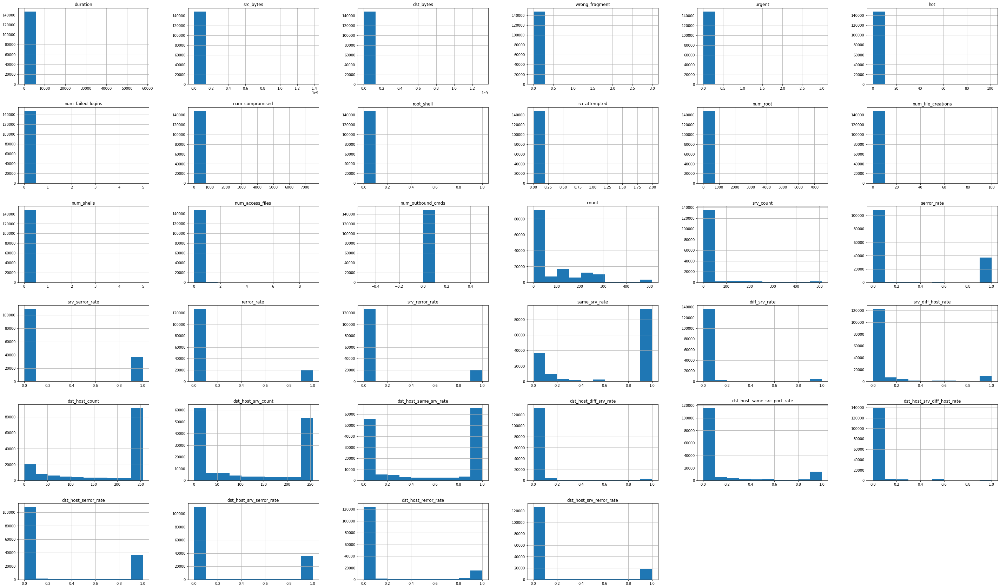

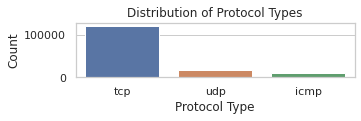

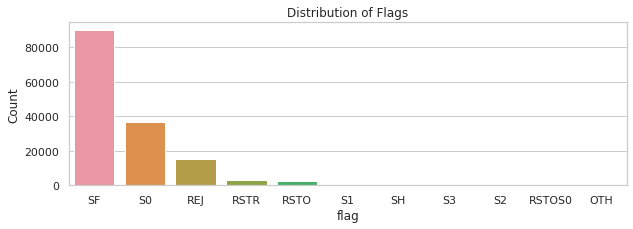

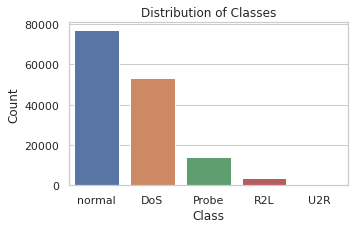

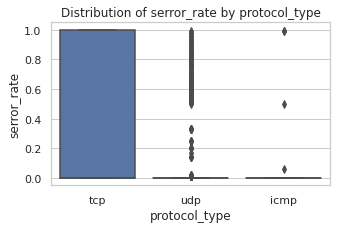

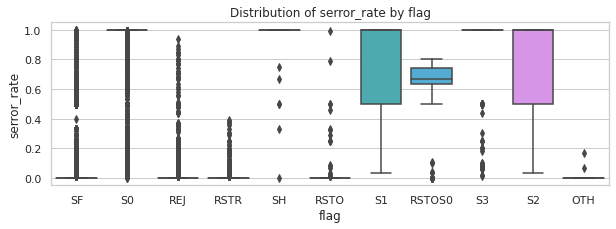

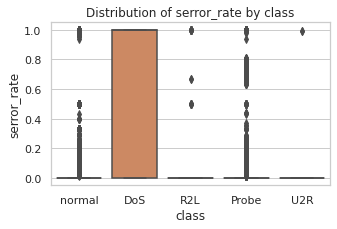

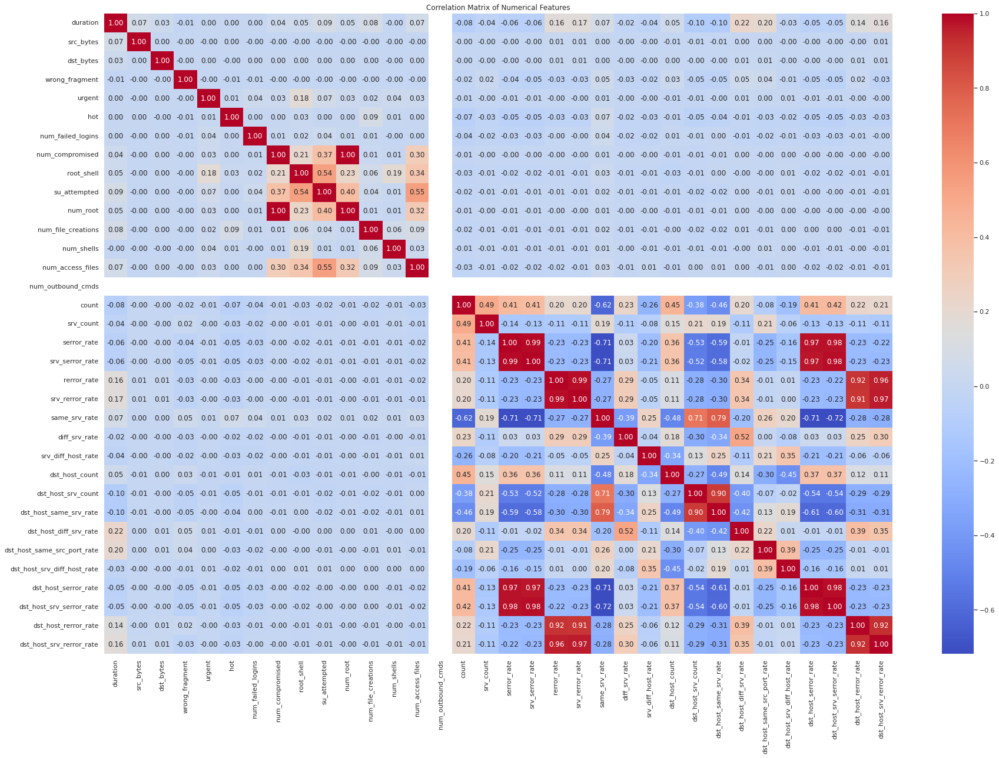

In [0]:
# Convert to Pandas DataFrame for better visualization using Matplotlib/Seaborn
df_pandas = df.toPandas()

# Select numeric columns
numeric_df = df_pandas.select_dtypes(include=[np.number]) 

# Histograms of Numerical Features
print("Histogram of Numerical Features")
numeric_df.hist(figsize=(50, 30))
plt.show()

# Set the style of the visualization
sns.set(style="whitegrid")

# Plot the distribution of 'protocol_type'
plt.figure(figsize=(5, 1))
sns.countplot(x='protocol_type', data=df_pandas, order=df_pandas['protocol_type'].value_counts().index)
plt.title('Distribution of Protocol Types')
plt.xlabel('Protocol Type')
plt.ylabel('Count')
plt.show()

# Plot the distribution of 'flag'
plt.figure(figsize=(10, 3))
sns.countplot(x='flag', data=df_pandas, order=df_pandas['flag'].value_counts().index)
plt.title('Distribution of Flags')
plt.xlabel('flag')
plt.ylabel('Count')
plt.show()

# Plot the distribution of the 'class' column to see the balance of classes
plt.figure(figsize=(5, 3))
sns.countplot(x='class', data=df_pandas, order=df_pandas['class'].value_counts().index)
plt.title('Distribution of Classes')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

# Distribution of serror_rate by protocol_type
plt.figure(figsize=(5, 3))
sns.boxplot(x ='protocol_type', y = 'serror_rate', data = df_pandas)
plt.title('Distribution of serror_rate by protocol_type')
plt.xlabel('protocol_type')
plt.ylabel('serror_rate')
plt.show()

# Distribution of serror_rate by flag
plt.figure(figsize=(10, 3))
sns.boxplot(x ='flag', y = 'serror_rate', data = df_pandas)
plt.title('Distribution of serror_rate by flag')
plt.xlabel('flag')
plt.ylabel('serror_rate')
plt.show()

# Distribution of serror_rate by class
plt.figure(figsize=(5, 3))
sns.boxplot(x ='class', y = 'serror_rate', data = df_pandas)
plt.title('Distribution of serror_rate by class')
plt.xlabel('class')
plt.ylabel('serror_rate')
plt.show()

# Plot the correlation matrix to see the relationships between numerical features
plt.figure(figsize=(30, 20))
correlation_matrix = numeric_df.corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix of Numerical Features')
plt.show()

#####d. Try exploring the data and see what insights can be drawn from the dataset.

######i. Identify unique columns data types

In [0]:
print('Columns data types and count')
dtypes_df=spark.createDataFrame(df.dtypes, schema = "ColumnName string, DataType string")
display(dtypes_df.groupby("DataType").count())

Columns data types and count


DataType,count
float,34
string,8


######ii. Identify unique class and count

In [0]:
print('Unique class and count')
display(df.groupby("class").count() .orderBy("count", ascending=False))

Unique class and count


class,count
normal,77054
DoS,53385
Probe,14077
R2L,3749
U2R,252


######iii. Identify columns and number of unique values across all rows

In [0]:
# Print the columns and number of unique values across all rows
print("Columns and number of unique values across all rows:")
for col in df.columns:
    count = df.select(col).distinct().count()
    print(f'{col}: {count}')

Columns and number of unique values across all rows:
duration: 3424
protocol_type: 3
service: 70
flag: 11
src_bytes: 3601
dst_bytes: 10401
land: 2
wrong_fragment: 3
urgent: 4
hot: 29
num_failed_logins: 6
logged_in: 2
num_compromised: 96
root_shell: 2
su_attempted: 3
num_root: 91
num_file_creations: 36
num_shells: 4
num_access_files: 10
num_outbound_cmds: 1
is_host_login: 2
is_guest_login: 2
count: 512
srv_count: 512
serror_rate: 99
srv_serror_rate: 94
rerror_rate: 98
srv_rerror_rate: 95
same_srv_rate: 101
diff_srv_rate: 101
srv_diff_host_rate: 87
dst_host_count: 256
dst_host_srv_count: 256
dst_host_same_srv_rate: 101
dst_host_diff_srv_rate: 101
dst_host_same_src_port_rate: 101
dst_host_srv_diff_host_rate: 75
dst_host_serror_rate: 101
dst_host_srv_serror_rate: 101
dst_host_rerror_rate: 101
dst_host_srv_rerror_rate: 101
class: 5


####3. Data Pre-processing and cleaning
****

#####a. Do the appropriate preprocessing of the data like identifying NULL or Missing Values if any, handling of outliers if present in the dataset, skewed data etc. Apply appropriate feature engineering techniques for them.

%md
######i. Identify and handle the columns that have same value across all rows

In [0]:
# Get the column count of the dataset
original_col_count = len(df.columns)

# Delete the columns that have single distint value across all rows
df = df.drop(*(col for col in df.columns if df.select(col).distinct().count() == 1))

# Print the number of deleted columns that have same value across all rows deleted
print(f"Number of deleted columns that have same value across all rows: {original_col_count - len(df.columns)}")

Number of deleted columns that have same value across all rows: 1


######ii. Identify and handle duplicate rows

In [0]:
# Get the row count of the dataset
original_row_count = df.count()

# Drop duplicates based on all columns
df = df.dropDuplicates()

# Print the number of duplicate rows deleted
print(f"Number of duplicate rows deleted: {original_row_count - df.count()}")


Number of duplicate rows deleted: 629


######iii. Identify and handle skewed data

In [0]:
# Identify skewed data using distribution of data among paritions
print("Skewed data:")
display(df.groupBy(F.spark_partition_id()).count())

# Use salting technique to handle skewed data 
# by adding a salt column with random data
df = df.withColumn('salt', F.rand())

# Repartition by salt column
df = df.repartition(8, 'salt')

# Print distribution of data among paritions
print("After treating skewed data:")
display(df.groupBy(F.spark_partition_id()).count())

Skewed data:


SPARK_PARTITION_ID(),count
0,18435
1,17791
2,18348
3,17861
4,17805
5,18449
6,18447
7,20752


After treating skewed data:


SPARK_PARTITION_ID(),count
0,18627
1,18606
2,18350
3,18633
4,18473
5,18274
6,18626
7,18299


######iv. Identify and handle NULL or missing values such as NaN, None

In [0]:
# Identify and treat columns with missing values 
hasMissing = False
for column in df.columns: 
    # string numeric columns with zeroes, None, NaN
    if (df.schema[column].dataType.typeName() == "float"):
        # Count the number of missing values
        missing_count = df.filter(df[column].isin([None,np.NaN])).count()

        # Check for missing values
        if missing_count > 0:
            # Display column that has missing values
            hasMissing = True
            print(f"Column {column} has {missing_count} missing values.")
            
            # Initialize the Imputer for treating missing float values with mean
            imputer = Imputer(inputCols= [column], outputCols=[column], strategy="mean")

            # Fit the Imputer
            imputer_model = imputer.fit(df)

            # Transform the dataset
            df = imputer_model.transform(df)
                    
    # Check string columns with None and Null values
    if (df.schema[column].dataType.typeName()== "string"):
        # Count the number of missing values
        missing_count = df.filter(df[column].eqNullSafe(None) | df[column].isNull()).count()

        # Check for missing values
        if missing_count > 0:
            # Display column that has missing values
            hasMissing = True
            print(f"Column {column} has {missing_count} missing values.")
            
            # Initialize the Imputer for treating missing string values with mode
            imputer = Imputer(inputCols= [column], outputCols=[column], strategy="mode")

            # Fit the Imputer
            imputer_model = imputer.fit(df)

            # Transform the dataset
            df = imputer_model.transform(df)

# Check for missing values
if not hasMissing:
    print("There are no columns with missing values")

There are no columns with missing values


######iv. Identify and handle outliers jsing Z-Score

In [0]:
# Get all numerical columns except salt (as salt data type is double)
numeric_columns = [column[0] for column in df.dtypes if column[1]=='float']

# Treat each outlier
threshold = 2.5
for column in numeric_columns:
	# Calculate mean and standard deviation
	stats = df.select(F.mean(F.col(column)).alias('mean'), F.stddev(F.col(column)).alias('stddev')).collect()[0]

	# Calculate z-scores and filter outliers
	df = df.withColumn(f'{column}_z_score', (F.col(column) - stats['mean']) / stats['stddev']) \
		   .filter(f'abs({column}_z_score) <= {threshold}') \
		   .drop(f'{column}_z_score')
     
# Number of rows after treating outliers
print(f"After treating all column outliers, number of rows in the data set: {df.count()}")       

After treating all column outliers, number of rows in the data set: 90532


#####b. Apply the feature transformation techniques like Standardization, Normalization, etc. You are free to apply the appropriate transformations depending upon the structure and the complexity of your dataset.

######i. Apply StringIndexer to transform categorical features into numerical

In [0]:
# Get list of categorical features
string_columns = [column[0] for column in df.dtypes if column[1]=='string']

# Convert each categorical feature into numerical
class_index_df = None
for column in string_columns:
    # Create a StringIndexer transformer
    indexer = StringIndexer(inputCol=column, outputCol=column + "_index")

    # Fit to dataframe and apply transformation onto dataframe
    df = indexer.fit(df).transform(df)

    # Check for class column
    if(column == 'class'):
        # Get the class and index
        class_index_df = df.select(column, column + "_index").distinct()

    # Drop the original columns
    df = df.drop(column)

    # Rename column index to original column
    df = df.withColumnRenamed(column + "_index", column)

# Display the tranformed dataframe
display(df[string_columns])

# Display column and index datafram
display(class_index_df)

protocol_type,service,flag,land,logged_in,is_host_login,is_guest_login,class
0.0,32.0,1.0,0.0,1.0,0.0,0.0,1.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0
0.0,13.0,1.0,0.0,1.0,0.0,0.0,1.0
0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0
2.0,50.0,0.0,0.0,1.0,0.0,0.0,3.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,38.0,1.0,0.0,1.0,0.0,0.0,1.0
0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0


class,class_index
DoS,1.0
R2L,2.0
Probe,3.0
U2R,4.0
normal,0.0


######ii. Apply Normalization that transforms a dataset of Vector rows, normalizing each Vector to have unit norm

In [0]:
# features except salt and class
exclude_columns = ['salt', 'class']
feature_columns = [col for col in df.columns if col not in exclude_columns]

# Create an assembler
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")

# Apply assembler on dataset
df = assembler.transform(df)
print(f"Assembled columns {feature_columns} to vector column 'features'")

# Normalize each Vector using 1 norm.
normalizer = Normalizer(inputCol="features", outputCol="normFeatures", p=1.0)

# Apply transformation onto dataframe
df = normalizer.transform(df)

# Display the tranformed dataframe
display(df)

Assembled columns ['duration', 'src_bytes', 'dst_bytes', 'wrong_fragment', 'urgent', 'hot', 'num_failed_logins', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'num_shells', 'num_access_files', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'dst_host_srv_diff_host_rate', 'dst_host_serror_rate', 'dst_host_srv_serror_rate', 'dst_host_rerror_rate', 'dst_host_srv_rerror_rate', 'protocol_type', 'service', 'flag', 'land', 'logged_in', 'is_host_login', 'is_guest_login'] to vector column 'features'


duration,src_bytes,dst_bytes,wrong_fragment,urgent,hot,num_failed_logins,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,salt,protocol_type,service,flag,land,logged_in,is_host_login,is_guest_login,class,features,normFeatures
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,223.0,21.0,1.0,1.0,0.0,0.0,0.09,0.05,0.0,255.0,21.0,0.08,0.05,0.0,0.0,1.0,1.0,0.0,0.0,0.3863092665955863,0.0,32.0,1.0,0.0,1.0,0.0,0.0,1.0,"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(223.0, 21.0, 1.0, 1.0, 0.09000000357627869, 0.05000000074505806, 255.0, 21.0, 0.07999999821186066, 0.05000000074505806, 1.0, 1.0, 32.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(0.3994482956252181, 0.03761620721134341, 0.0017912479624449243, 0.0017912479624449243, 1.6121232302604508E-4, 8.956239945682994E-5, 0.45676823042345566, 0.03761620721134341, 1.43299833792593E-4, 8.956239945682994E-5, 0.0017912479624449243, 0.0017912479624449243, 0.057319934798237576, 0.0017912479624449243, 0.0017912479624449243))"
0.0,286.0,1425.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,221.0,225.0,1.0,0.0,0.0,0.01,0.01,0.01,0.0,0.0,0.3479995278000304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(286.0, 1425.0, 2.0, 2.0, 1.0, 221.0, 225.0, 1.0, 0.009999999776482582, 0.009999999776482582, 0.009999999776482582))","Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(0.1322219294231188, 0.6587980749228821, 9.246288770847469E-4, 9.246288770847469E-4, 4.6231443854237344E-4, 0.10217149091786452, 0.10402074867203402, 4.6231443854237344E-4, 4.623144282088405E-6, 4.623144282088405E-6, 4.623144282088405E-6))"
0.0,46.0,132.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,23.0,85.0,0.0,0.0,0.0,0.0,1.0,0.0,0.02,255.0,181.0,0.71,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.159160216753648,1.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 22, 23, 24, 25, 26, 33, 34, 37), values -> List(46.0, 132.0, 23.0, 85.0, 1.0, 0.019999999552965164, 255.0, 181.0, 0.7099999785423279, 0.009999999776482582, 1.0, 4.0, 1.0))","Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 22, 23, 24, 25, 26, 33, 34, 37), values -> List(0.06303614986350602, 0.18088634308658247, 0.03151807493175301, 0.1164798421390872, 0.0013703510839892612, 2.740702106719055E-5, 0.3494395264172616, 0.24803354620205628, 9.729492402278312E-4, 1.3703510533595275E-5, 0.0013703510839892612, 0.005481404335957045, 0.0013703510839892612))"
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,272.0,23.0,1.0,1.0,0.0,0.0,0.08,0.05,0.0,255.0,23.0,0.09,0.05,0.0,0.0,1.0,1.0,0.0,0.0,0.11092068568811109,0.0,13.0,1.0,0.0,1.0,0.0,0.0,1.0,"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(272.0, 23.0, 1.0, 1.0, 0.07999999821186066, 0.05000000074505806, 255.0, 23.0, 0.09000000357627869, 0.05000000074505806, 1.0, 1.0, 13.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(0.45925000421850587, 0.038833640062594245, 0.0016884191331562714, 0.0016884191331562714, 1.3507352763337304E-4, 8.442095791578385E-5, 0.4305468789548492, 0.038833640062594245, 1.519577280223218E-4, 8

######iii. Apply Standardization that transforms a dataset of Vector rows, normalizing each feature to have unit standard deviation and/or zero mean

In [0]:
# Standardize each Vector using unit standard deviation and zero mean 
scaler = StandardScaler(inputCol="features", outputCol="scaledFeatures",
                    withStd=True, withMean=False)

# Compute summary statistics by fitting the StandardScaler
scalerModel = scaler.fit(df)

# Normalize each feature to have unit standard deviation.
df = scalerModel.transform(df)

# Display the tranformed dataframe
display(df)

duration,src_bytes,dst_bytes,wrong_fragment,urgent,hot,num_failed_logins,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,salt,protocol_type,service,flag,land,logged_in,is_host_login,is_guest_login,class,features,normFeatures,scaledFeatures
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,223.0,21.0,1.0,1.0,0.0,0.0,0.09,0.05,0.0,255.0,21.0,0.08,0.05,0.0,0.0,1.0,1.0,0.0,0.0,0.3863092665955863,0.0,32.0,1.0,0.0,1.0,0.0,0.0,1.0,"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(223.0, 21.0, 1.0, 1.0, 0.09000000357627869, 0.05000000074505806, 255.0, 21.0, 0.07999999821186066, 0.05000000074505806, 1.0, 1.0, 32.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(0.3994482956252181, 0.03761620721134341, 0.0017912479624449243, 0.0017912479624449243, 1.6121232302604508E-4, 8.956239945682994E-5, 0.45676823042345566, 0.03761620721134341, 1.43299833792593E-4, 8.956239945682994E-5, 0.0017912479624449243, 0.0017912479624449243, 0.057319934798237576, 0.0017912479624449243, 0.0017912479624449243))","Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(2.3508071936312125, 1.259153435520215, 2.057351565454735, 2.058520036771831, 0.20126443985831444, 1.117224263834044, 2.696626786731162, 0.1834049587571537, 0.1775886160911368, 1.3458806986576453, 2.060035794540411, 2.05725932766204, 2.673605477666591, 1.89982539292512, 2.002244523188728))"
0.0,286.0,1425.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,221.0,225.0,1.0,0.0,0.0,0.01,0.01,0.01,0.0,0.0,0.3479995278000304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(286.0, 1425.0, 2.0, 2.0, 1.0, 221.0, 225.0, 1.0, 0.009999999776482582, 0.009999999776482582, 0.009999999776482582))","Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(0.1322219294231188, 0.6587980749228821, 9.246288770847469E-4, 9.246288770847469E-4, 4.6231443854237344E-4, 0.10217149091786452, 0.10402074867203402, 4.6231443854237344E-4, 4.623144282088405E-6, 4.623144282088405E-6, 4.623144282088405E-6))","Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(0.0028626500724896684, 0.24242981055784624, 0.021083472588620738, 0.11991937481144904, 2.2362714651198274, 2.3370765485003404, 1.9650531295409326, 2.2198577507568973, 0.5579997146711587, 0.020600357484950226, 0.020572592816787107))"
0.0,46.0,132.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,23.0,85.0,0.0,0.0,0.0,0.0,1.0,0.0,0.02,255.0,181.0,0.71,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.159160216753648,1.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 22, 23, 24, 25, 26, 33, 34, 37), values -> List(46.0, 132.0, 23.0, 85.0, 1.0, 0.019999999552965164, 255.0, 181.0, 0.7099999785423279, 0.009999999776482582, 1.0, 4.0, 1.0))","Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 22, 23, 24, 25, 26, 33, 34, 37), values -> List(0.06303614986350602, 0.18088634308658247, 0.03151807493175301, 0.1164798421390872, 0.0013703510839892612, 2.740702106719055E-5, 0.3494395264172616, 0.24803354620205628, 9.729492402278312E-4, 1.3703510533595275E-5, 0.0013703510839892612, 0.005481404335957045, 0.0013703510839892612))","Map(vectorType -> sp

#####c. Do the correlational analysis on the dataset. Provide a visualization for the same.

######i. Correlational analysis on the dataset

In [0]:
#  correlation matrix
correlation_matrix = Correlation.corr(df, "features").head()

# print the correlation matrix
print("Pearson correlation matrix:\n" + str(correlation_matrix[0]))

Pearson correlation matrix:
DenseMatrix([[ 1.00000000e+00,  1.07553495e-02,  3.72136608e-02, ...,
              -1.41691761e-02,  1.01778768e-03,  2.31144873e-01],
             [ 1.07553495e-02,  1.00000000e+00, -7.19211124e-03, ...,
              -2.76239569e-02, -2.79804161e-04, -4.45351668e-03],
             [ 3.72136608e-02, -7.19211124e-03,  1.00000000e+00, ...,
              -3.17864958e-01, -1.24134070e-03, -1.67379129e-02],
             ...,
             [-1.41691761e-02, -2.76239569e-02, -3.17864958e-01, ...,
               1.00000000e+00, -4.48223625e-03, -7.19668464e-02],
             [ 1.01778768e-03, -2.79804161e-04, -1.24134070e-03, ...,
              -4.48223625e-03,  1.00000000e+00, -3.57593656e-04],
             [ 2.31144873e-01, -4.45351668e-03, -1.67379129e-02, ...,
              -7.19668464e-02, -3.57593656e-04,  1.00000000e+00]])


######ii. Visualization of Correlational Analysis

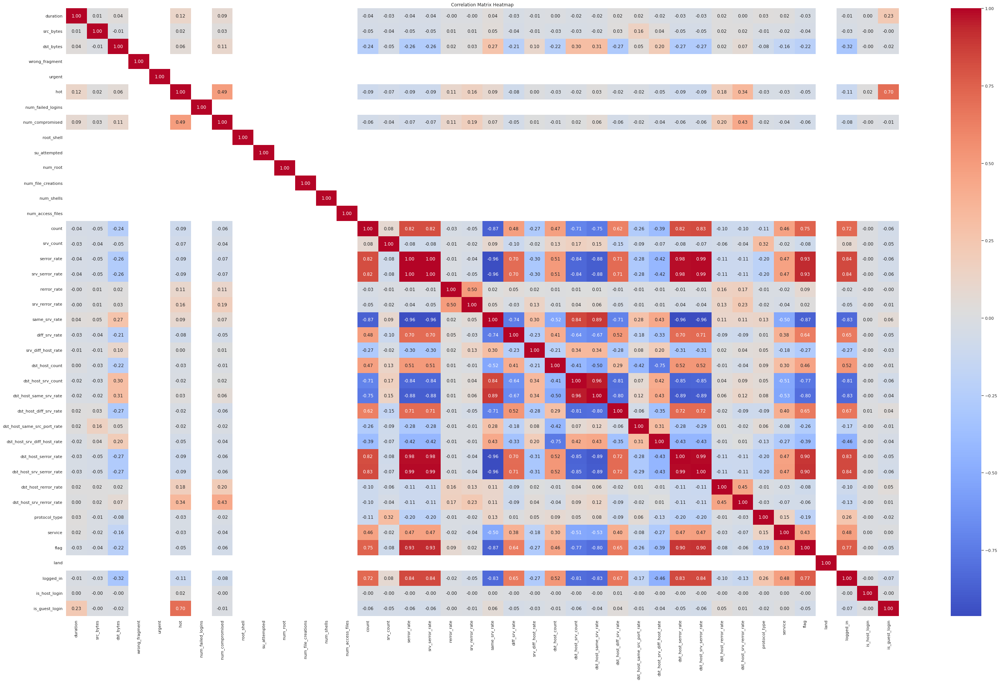

In [0]:
# Convert the correlation matrix to a NumpyArray
correlation_array = np.array(correlation_matrix[0].toArray())

# Create a pandas dataframe to plot heatmap
correlation_df = pd.DataFrame(correlation_array, columns=feature_columns, index=feature_columns)

#  correlation heatmap
plt.figure(figsize=(50, 30))
sns.heatmap(correlation_df, annot=True, cmap="coolwarm", fmt='.2f')
plt.title("Correlation Matrix Heatmap")
plt.show()

####4. Data Preparation
****

#####a. Do the final feature selection and extract them into Column X and the class label into Column into Y.

In [0]:
# Select features and class
df_prepared = df.select("features", "class")

# Rename features to X
df_prepared = df_prepared.withColumnRenamed("features", "X")

# Rename class to y
df_prepared = df_prepared.withColumnRenamed("class", "y")
display(df_prepared)

X,y
"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(223.0, 21.0, 1.0, 1.0, 0.09000000357627869, 0.05000000074505806, 255.0, 21.0, 0.07999999821186066, 0.05000000074505806, 1.0, 1.0, 32.0, 1.0, 1.0))",1.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 28, 29, 30), values -> List(286.0, 1425.0, 2.0, 2.0, 1.0, 221.0, 225.0, 1.0, 0.009999999776482582, 0.009999999776482582, 0.009999999776482582))",0.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 22, 23, 24, 25, 26, 33, 34, 37), values -> List(46.0, 132.0, 23.0, 85.0, 1.0, 0.019999999552965164, 255.0, 181.0, 0.7099999785423279, 0.009999999776482582, 1.0, 4.0, 1.0))",0.0
"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(272.0, 23.0, 1.0, 1.0, 0.07999999821186066, 0.05000000074505806, 255.0, 23.0, 0.09000000357627869, 0.05000000074505806, 1.0, 1.0, 13.0, 1.0, 1.0))",1.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 14, 15, 20, 23, 24, 25, 26, 27, 28, 34, 37), values -> List(12165.0, 3.0, 3.0, 1.0, 169.0, 43.0, 0.18000000715255737, 0.03999999910593033, 0.18000000715255737, 0.05000000074505806, 2.0, 1.0))",0.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 14, 15, 20, 23, 24, 26, 27, 33, 34, 37), values -> List(20.0, 1.0, 1.0, 1.0, 255.0, 1.0, 0.019999999552965164, 0.019999999552965164, 2.0, 50.0, 1.0))",3.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25), values -> List(325.0, 682.0, 13.0, 13.0, 1.0, 255.0, 255.0, 1.0))",0.0
"Map(vectorType -> sparse, length -> 40, indices -> List(1, 2, 14, 15, 20, 23, 24, 25, 27, 28, 31, 32), values -> List(335.0, 951.0, 4.0, 4.0, 1.0, 19.0, 255.0, 1.0, 0.05000000074505806, 0.07000000029802322, 0.10999999940395355, 0.05000000074505806))",0.0
"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 29, 30, 34, 35, 37), values -> List(290.0, 12.0, 1.0, 1.0, 0.03999999910593033, 0.05999999865889549, 255.0, 5.0, 0.019999999552965164, 0.07000000029802322, 1.0, 1.0, 38.0, 1.0, 1.0))",1.0
"Map(vectorType -> sparse, length -> 40, indices -> List(14, 15, 16, 17, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 34, 35, 37), values -> List(192.0, 9.0, 1.0, 1.0, 0.05000000074505806, 0.05999999865889549, 38.0, 9.0, 0.23999999463558197, 0.1599999964237213, 0.029999999329447746, 0.6299999952316284, 1.0, 0.029999999329447746, 1.0, 1.0, 1.0))",1.0


#####b. Split the dataset into training and test sets.

In [0]:
# Splitting the dataset into training and test sets (80% train, 20% test)
trainingData, testData = df_prepared.randomSplit([0.8, 0.2], seed=42)

####5. Model Building
****

#####a. Perform Model Development using at least three models, separately. You are free to apply any Machine Learning Models on the dataset by using MLlib- PySpark. Deep Learning Models are strictly not allowed.

In [0]:
# Logistic Regression
lr_model = LogisticRegression(featuresCol="X", labelCol="y",  maxIter=10)

# Decision Tree Classifier
dt_model = DecisionTreeClassifier(featuresCol="X", labelCol="y", maxBins=100)

# Random Forest Classifier
rf_model = RandomForestClassifier(featuresCol="X", labelCol="y", maxBins=100)

#####b.  Train the model and print the training accuracy and loss values.


In [0]:
# Create evaluators for metrics accuracy and loss values
evaluator_accuracy = MulticlassClassificationEvaluator(labelCol="y", predictionCol="prediction", metricName="accuracy")
evaluator_loss = MulticlassClassificationEvaluator(labelCol="y", predictionCol="prediction", metricName="logLoss")

# Train the model
lr_model = lr_model.fit(trainingData)

# Apply the model
lr_predictions = lr_model.transform(trainingData)

# Evaluate the model
lr_accuracy = evaluator_accuracy.evaluate(lr_predictions)
lr_loss = evaluator_loss.evaluate(lr_predictions)

# Print the metrics
print(f"Logistic Regression Training Accuracy: {lr_accuracy}")
print(f"Logistic Regression Training Loss: {lr_loss}")

# Train the model
dt_model = dt_model.fit(trainingData)

# Apply the model
dt_predictions = dt_model.transform(trainingData)

# Evaluate the model
dt_accuracy = evaluator_accuracy.evaluate(dt_predictions)
dt_loss = evaluator_loss.evaluate(dt_predictions)

# Print the metrics
print(f"Decision Tree Training Accuracy: {dt_accuracy}")
print(f"Decision Tree Training Loss: {dt_loss}")

# Train the model
rf_model = rf_model.fit(trainingData)

# Apply the model
rf_predictions = rf_model.transform(trainingData)

# Evaluate the model
rf_accuracy = evaluator_accuracy.evaluate(rf_predictions)
rf_loss = evaluator_loss.evaluate(rf_predictions)

# Print the metrics
print(f"Random Forest Training Accuracy: {rf_accuracy}")
print(f"Random Forest Training Loss: {rf_loss}")

Logistic Regression Training Accuracy: 0.9798276051993832
Logistic Regression Training Loss: 0.06779130745715804
Decision Tree Training Accuracy: 0.9939138576779026
Decision Tree Training Loss: 0.025358346055251516
Random Forest Training Accuracy: 0.9866022251597268
Random Forest Training Loss: 0.04501030837876058


####6. Performance Evaluation
****

#####a. Print the confusion matrix. Provide appropriate analysis for the same.

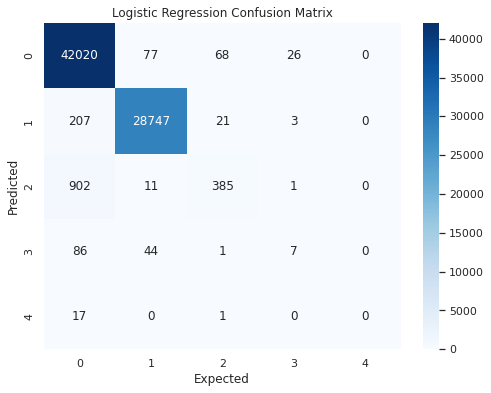

Logistic Regression model predicted 71159 times correctly out of 72624 times


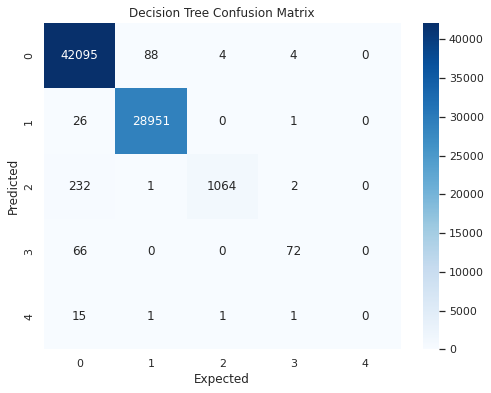

Decision Tree model predicted 72182 times correctly out of 72624 times


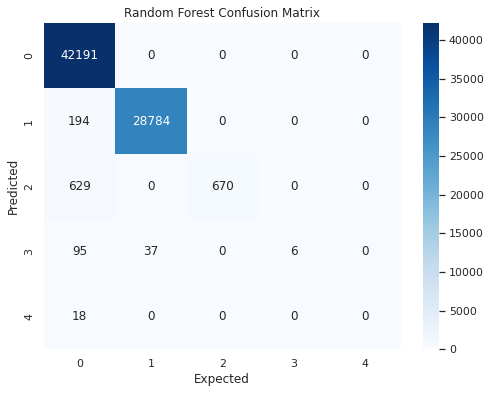

Random Forest model predicted 71651 times correctly out of 72624 times


In [0]:
# Confusion Matrix for Logistic Regression
predictions_and_labels = lr_predictions.select("prediction", "y").toPandas()
y_true = predictions_and_labels["y"]
y_pred = predictions_and_labels["prediction"]
conf_matrix = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Expected")
plt.ylabel("Predicted")
plt.title("Logistic Regression Confusion Matrix")
plt.show()

# Calculate sums
TPSum = 0
TotalSum = 0
for i in range(5):
    for j in range(5):
        TotalSum = TotalSum + conf_matrix[i][j]
        if(i == j):
            TPSum = TPSum + conf_matrix[i][j]

# Print analysis
print(f"Logistic Regression model predicted {TPSum} times correctly out of {TotalSum} times")

# Confusion Matrix for Decision Tree Classifier
predictions_and_labels = dt_predictions.select("prediction", "y").toPandas()
y_true = predictions_and_labels["y"]
y_pred = predictions_and_labels["prediction"]
conf_matrix = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Expected")
plt.ylabel("Predicted")
plt.title("Decision Tree Confusion Matrix")
plt.show()

# Calculate sums
TPSum = 0
TotalSum = 0
for i in range(5):
    for j in range(5):
        TotalSum = TotalSum + conf_matrix[i][j]
        if(i == j):
            TPSum = TPSum + conf_matrix[i][j]

# Print analysis
print(f"Decision Tree model predicted {TPSum} times correctly out of {TotalSum} times")

# Confusion Matrix for Random Forest Classifier
predictions_and_labels = rf_predictions.select("prediction", "y").toPandas()
y_true = predictions_and_labels["y"]
y_pred = predictions_and_labels["prediction"]
conf_matrix = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Expected")
plt.ylabel("Predicted")
plt.title("Random Forest Confusion Matrix")
plt.show()

# Calculate sums
TPSum = 0
TotalSum = 0
for i in range(5):
    for j in range(5):
        TotalSum = TotalSum + conf_matrix[i][j]
        if(i == j):
            TPSum = TPSum + conf_matrix[i][j]

# Print analysis
print(f"Random Forest model predicted {TPSum} times correctly out of {TotalSum} times")

#####b. Do the prediction for the test data and display the results for the inference.

In [0]:
# Prediction for the test data using Logistic Regression
lr_test_predictions = lr_model.transform(testData)

# Display predictions
print("Logistic Regression Predictions:")
display(lr_test_predictions.select("X", "y", "prediction", "probability").limit(5))

#  Display accuracy
lr_test_accuracy = evaluator_accuracy.evaluate(lr_test_predictions)
print(f"Logistic Regression Test Accuracy: {lr_test_accuracy}")

# Prediction for the test data using Decision Tree
dt_test_predictions = dt_model.transform(testData)

# Display predictions
print("Decision Tree Predictions:")
display(dt_test_predictions.select("X", "y", "prediction", "probability").limit(5))

#  Display accuracy
dt_test_accuracy = evaluator_accuracy.evaluate(dt_test_predictions)
print(f"Decision Tree Test Accuracy: {dt_test_accuracy}")

# Prediction for the test data using Random Forest
rf_test_predictions = rf_model.transform(testData)

# Display predictions
print("Random Forest Predictions:")
display(lr_test_predictions.select("X", "Y", "prediction", "probability").limit(5))

#  Display accuracy
rf_test_accuracy = evaluator_accuracy.evaluate(rf_test_predictions)
print(f"Random Forest Test Accuracy: {rf_test_accuracy}")

Logistic Regression Predictions:


X,y,prediction,probability
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26), values -> List(4.0, 180.0, 1911.0, 1.0, 1.0, 1.0, 1.0, 255.0, 254.0, 1.0, 0.009999999776482582))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.979456312614283, 0.0092850044663813, 0.010927559130558831, 2.553372855932626E-4, 7.578650318361004E-5))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 29, 31, 34, 39), values -> List(283.0, 162.0, 599.0, 2.0, 1.0, 1.0, 1.0, 255.0, 99.0, 0.38999998569488525, 0.029999999329447746, 0.009999999776482582, 0.019999999552965164, 0.009999999776482582, 7.0, 1.0))",2.0,2.0,"Map(vectorType -> dense, length -> 5, values -> List(0.04670105930768714, 2.7574146477863137E-6, 0.9532344071910235, 4.8762156569581205E-5, 1.3013930072222437E-5))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 31, 32, 34, 39), values -> List(21.0, 231.0, 770.0, 4.0, 1.0, 1.0, 1.0, 175.0, 38.0, 0.2199999988079071, 0.03999999910593033, 0.009999999776482582, 0.009999999776482582, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8456925147395196, 0.14547763551706364, 0.007627947670360029, 9.019956764895464E-4, 2.9990639656711965E-4))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(20.0, 224.0, 764.0, 4.0, 1.0, 1.0, 1.0, 37.0, 9.0, 0.23999999463558197, 0.05000000074505806, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8361312483947331, 0.024931372929265082, 0.13613958252509537, 0.002267548819290311, 5.302473316163388E-4))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(22.0, 238.0, 767.0, 4.0, 1.0, 1.0, 1.0, 44.0, 26.0, 0.5899999737739563, 0.09000000357627869, 0.019999999552965164, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.7246688537418584, 0.027511866998352785, 0.24464928748494152, 0.0025492190194039946, 6.207727554433045E-4))"


Logistic Regression Test Accuracy: 0.980958230958231
Decision Tree Predictions:


X,y,prediction,probability
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26), values -> List(4.0, 180.0, 1911.0, 1.0, 1.0, 1.0, 1.0, 255.0, 254.0, 1.0, 0.009999999776482582))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.9973864994026285, 9.956192751891676E-5, 0.0021405814416567107, 1.9912385503783353E-4, 1.7423337315810433E-4))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 29, 31, 34, 39), values -> List(283.0, 162.0, 599.0, 2.0, 1.0, 1.0, 1.0, 255.0, 99.0, 0.38999998569488525, 0.029999999329447746, 0.009999999776482582, 0.019999999552965164, 0.009999999776482582, 7.0, 1.0))",2.0,2.0,"Map(vectorType -> dense, length -> 5, values -> List(0.0, 0.0, 1.0, 0.0, 0.0))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 31, 32, 34, 39), values -> List(21.0, 231.0, 770.0, 4.0, 1.0, 1.0, 1.0, 175.0, 38.0, 0.2199999988079071, 0.03999999910593033, 0.009999999776482582, 0.009999999776482582, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8667180277349769, 0.010015408320493066, 0.09553158705701079, 0.023882896764252697, 0.003852080123266564))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(20.0, 224.0, 764.0, 4.0, 1.0, 1.0, 1.0, 37.0, 9.0, 0.23999999463558197, 0.05000000074505806, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8667180277349769, 0.010015408320493066, 0.09553158705701079, 0.023882896764252697, 0.003852080123266564))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(22.0, 238.0, 767.0, 4.0, 1.0, 1.0, 1.0, 44.0, 26.0, 0.5899999737739563, 0.09000000357627869, 0.019999999552965164, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8667180277349769, 0.010015408320493066, 0.09553158705701079, 0.023882896764252697, 0.003852080123266564))"


Decision Tree Test Accuracy: 0.9931315613133795
Random Forest Predictions:


X,Y,prediction,probability
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26), values -> List(4.0, 180.0, 1911.0, 1.0, 1.0, 1.0, 1.0, 255.0, 254.0, 1.0, 0.009999999776482582))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.979456312614283, 0.0092850044663813, 0.010927559130558831, 2.553372855932626E-4, 7.578650318361004E-5))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 29, 31, 34, 39), values -> List(283.0, 162.0, 599.0, 2.0, 1.0, 1.0, 1.0, 255.0, 99.0, 0.38999998569488525, 0.029999999329447746, 0.009999999776482582, 0.019999999552965164, 0.009999999776482582, 7.0, 1.0))",2.0,2.0,"Map(vectorType -> dense, length -> 5, values -> List(0.04670105930768714, 2.7574146477863137E-6, 0.9532344071910235, 4.8762156569581205E-5, 1.3013930072222437E-5))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 31, 32, 34, 39), values -> List(21.0, 231.0, 770.0, 4.0, 1.0, 1.0, 1.0, 175.0, 38.0, 0.2199999988079071, 0.03999999910593033, 0.009999999776482582, 0.009999999776482582, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8456925147395196, 0.14547763551706364, 0.007627947670360029, 9.019956764895464E-4, 2.9990639656711965E-4))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(20.0, 224.0, 764.0, 4.0, 1.0, 1.0, 1.0, 37.0, 9.0, 0.23999999463558197, 0.05000000074505806, 0.029999999329447746, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.8361312483947331, 0.024931372929265082, 0.13613958252509537, 0.002267548819290311, 5.302473316163388E-4))"
"Map(vectorType -> sparse, length -> 40, indices -> List(0, 1, 2, 5, 14, 15, 20, 23, 24, 25, 26, 27, 34, 39), values -> List(22.0, 238.0, 767.0, 4.0, 1.0, 1.0, 1.0, 44.0, 26.0, 0.5899999737739563, 0.09000000357627869, 0.019999999552965164, 7.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 5, values -> List(0.7246688537418584, 0.027511866998352785, 0.24464928748494152, 0.0025492190194039946, 6.207727554433045E-4))"


Random Forest Test Accuracy: 0.9870448961358053
